In [1]:
# GSE161801_01.Preproc_v01
# Alberto Bejarano (2024)

In [2]:
# https://pmc.ncbi.nlm.nih.gov/articles/PMC7779747/
# https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE279781
# https://www.cell.com/iscience/pdf/S2589-0042(24)02796-2.pdf

In [3]:
!jupyter nbextension enable --py widgetsnbextension

Enabling notebook extension jupyter-js-widgets/extension...
      - Validating: ok


In [4]:
import sys
variables = {var: sys.getsizeof(obj) / (1024**2)  # List variables with their memory size
             for var, obj in globals().items() if not var.startswith("__")}
for var, size in variables.items():
    print(f"{var}: {size:.2f} MB", end=" ")
    
print([var for var in dir() if not var.startswith('__')])
%reset -f

_ih: 0.00 MB _oh: 0.00 MB _dh: 0.00 MB In: 0.00 MB Out: 0.00 MB get_ipython: 0.00 MB exit: 0.00 MB quit: 0.00 MB open: 0.00 MB _: 0.00 MB _i: 0.00 MB _ii: 0.00 MB _iii: 0.00 MB _i1: 0.00 MB _i2: 0.00 MB _i3: 0.00 MB _exit_code: 0.00 MB _i4: 0.00 MB sys: 0.00 MB ['In', 'Out', '_', '_dh', '_exit_code', '_i', '_i1', '_i2', '_i3', '_i4', '_ih', '_ii', '_iii', '_oh', 'exit', 'get_ipython', 'open', 'quit', 'size', 'sys', 'var', 'variables']


In [5]:
import time; code_start = time.time()
from datetime import datetime; print(datetime.now().strftime("%B %d, %Y %H:%M:%S"))

In [6]:
#!conda info --envs

In [7]:
import warnings; warnings.filterwarnings("ignore") 
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=RuntimeWarning)

In [8]:
import pandas as pd;
pd.options.display.float_format = ' {:.3f}' .format
pd.options.display.max_columns = None
pd.options.display.width = 1000
#         .         .         .         .         .         .         .         .
from mpl_toolkits.axes_grid1 import make_axes_locatable
from IPython.display import Audio, display
from matplotlib.pyplot import rc_context
#from adjustText import adjust_text
import matplotlib.pyplot as plt
from itertools import product
import matplotlib.transforms
import autograd.numpy as np
from scipy import stats
import seaborn as sns; sns.__version__
import anndata as ad

In [9]:
import scipy.io as sio
import scanpy as sc
import scipy
import gzip
import os, gc

In [10]:
sc.settings.set_figure_params(scanpy=True, dpi=150, dpi_save=150, color_map='coolwarm',facecolor='white',
                             format='png', transparent=False, frameon=False, vector_friendly=True, fontsize=14)
sc.settings.verbosity = 0    # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
sc.logging.print_header()

scanpy==1.10.1 anndata==0.10.7 umap==0.5.6 numpy==1.26.4 scipy==1.13.0 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


In [11]:
HVG_h5ad_file_path     = '../../data/GSE279781/GSE279781_HVG.h5ad'
pcHVG_h5ad_file_path   = '../../data/GSE279781/GSE279781_pcHVG.h5ad'

In [12]:
HVG_data = ad.read(HVG_h5ad_file_path); print('\n', HVG_data, '\n')
pcHVG_data = HVG_data.copy()     # Just to keep naming canvention consistent
del HVG_data; gc.collect();       # Delete df and force garbage collection to release memory


 AnnData object with n_obs × n_vars = 115633 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'log1p' 



In [13]:
# Downsample the observations (cells)
print("Remaining cells:\t {}".format(pcHVG_data.n_obs))
num_cells_to_sample = int(0.05 * pcHVG_data.n_obs)
# Randomly select the indices of the cells to keep
random_indices = np.random.choice(pcHVG_data.obs_names, size=num_cells_to_sample, replace=False)
pcHVG_data = pcHVG_data[random_indices, :]   # Subset the AnnData object based on the selected indices
# Check the shape of the downsampled data
print("Remaining cells:\t {}".format(pcHVG_data.n_obs), '\n')

Remaining cells:	 115633
Remaining cells:	 5781 



In [14]:
sc.pp.scale(pcHVG_data, max_value=10)        # Scaling the data
sc.tl.pca(pcHVG_data, svd_solver='arpack')   # performing PCA
pcHVG_data

AnnData object with n_obs × n_vars = 5781 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

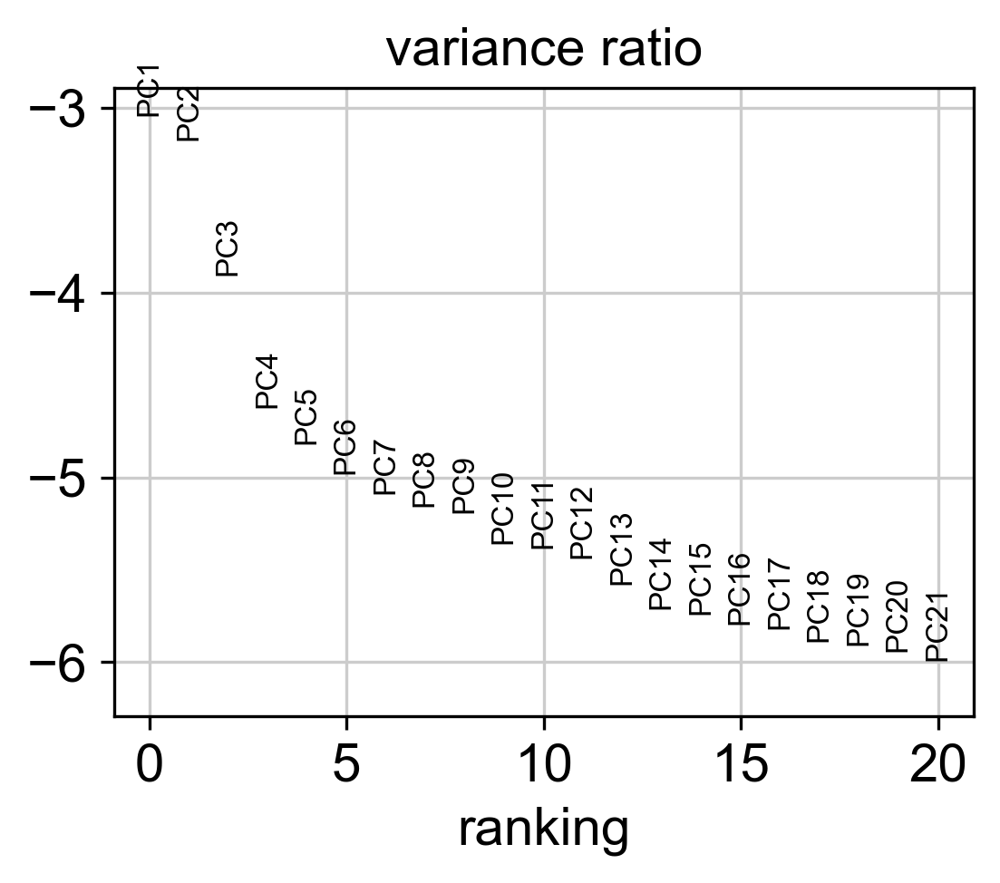

In [15]:
with rc_context({'figure.figsize':(4, 3), "font.size":12}):
    sc.pl.pca_variance_ratio(pcHVG_data, log=True, n_pcs=20, save='')

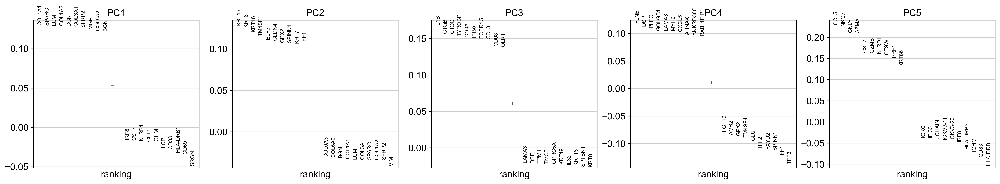

In [16]:
# Rank genes according to contributions to PCs.
with rc_context({'figure.figsize':(5, 4), "font.size":24}):
    sc.pl.pca_loadings(pcHVG_data, components = '1,2,3,4,5', include_lowest=True, n_points=20)

In [17]:
pca_loadings = pcHVG_data.varm['PCs']   # Extract the PCA loadings // PCA loadings matrix
# Create a DataFrame for better readability
pca_loadings_df = pd.DataFrame(pca_loadings,index=pcHVG_data.var_names, 
                               columns=[f"PC{i+1}" for i in range(pca_loadings.shape[1])])
top_genes = {}  # Dictionary to store top genes for each PC
num_genes = 5   # Number of top genes to select per PC
num_PCs   = 5   # Number of PCs
#         .         .         .         .         .         .         .         .         .         .         .         .
for pc in pca_loadings_df.columns[:num_PCs]:
    top_genes[pc] = pca_loadings_df[pc].abs().nlargest(num_genes).index.tolist()
#         .         .         .         .         .         .         .         .         .         .         .         .
for pc, genes in top_genes.items():     # Display the top genes
    print(f"\033[31mTop {num_genes} genes for {pc}:\033[0m", genes)

Top 5 genes for PC1: ['COL1A1', 'SPARC', 'LUM', 'COL1A2', 'DCN']
Top 5 genes for PC2: ['KRT19', 'KRT8', 'KRT18', 'TM4SF1', 'ELF3']
Top 5 genes for PC3: ['IL1B', 'C1QB', 'C1QC', 'TYROBP', 'C1QA']
Top 5 genes for PC4: ['TFF3', 'TFF1', 'FLNB', 'DSP', 'SPINK1']
Top 5 genes for PC5: ['CCL5', 'NKG7', 'GNLY', 'GZMA', 'CST7']


In [18]:
%time
# Compute the neighborhood graph for the given data
# `sc.pp.neighbors` is used to compute the nearest neighbors for each cell in the dataset based on a specified number of principal components (PCs).
sc.pp.neighbors(pcHVG_data, n_neighbors=10, n_pcs=30)

CPU times: total: 0 ns
Wall time: 0 ns


In [19]:
%%time
# Define the list of resolution values and corresponding key names
resolutions = [0.10, 0.25, 0.50, 0.75, 1.00, 1.25, 1.50, 2.00]  # "1.00" is the default resolution
key_names = [f"leiden_{res}" for res in resolutions]
for resolution in resolutions:               # Loop through the resolutions and apply the leiden algorithm
    key_name = f"leiden_{resolution:.2f}"    # Format the resolution to two decimal places for the key name
    sc.tl.leiden(pcHVG_data, resolution=resolution, key_added=key_name)

CPU times: total: 4.52 s
Wall time: 4.53 s


In [20]:
'''
adata_temp = pcHVG_data.copy()  # Copy adata not to modify UMAP in the original adata object
#         .         .         .         .         .         .         .         .         .         .         .         .
MIN_DISTS = [0.1, 0.5, 1, 2, 5, 10, 20]; SPREADS = [0.5, 1, 5, 10, 15, 25]  # List of values for min_dist and spread
#MIN_DISTS = [1, 3, 5, 10];               SPREADS = [0.5, 1, 5, 10]
#MIN_DISTS = [3, 10];                     SPREADS = [1, 5, 10]
#         .         .         .         .         .         .         .         .         .         .         .         .
fig, axes = plt.subplots(len(MIN_DISTS), len(SPREADS), figsize=(15, 15), squeeze=False)
#         .         .         .         .         .         .         .         .         .         .         .         .
for i, min_dist in enumerate(MIN_DISTS):
    for j, spread in enumerate(SPREADS):
        ax = axes[i, j]; param_str = f"min_dist = {min_dist}, spread = {spread}"
        sc.tl.umap(adata_temp, min_dist=min_dist, spread=spread, random_state=42)  # Recompute UMAP with new parameters
        kws = {'s': 60, 'add_outline': True, 'outline_width': (0.2, 0.01), 'outline_color': ('#545955', 'white')}
        sc.pl.umap(adata_temp, color=["leiden_1.00"], title='', legend_loc=None, show=False, **kws, ax=ax)
        if i == 0:   # Add title for top subplots (SPREAD values)
            ax.set_title(f"Spread = {spread}", fontsize=16)
#         .         .         .         .         .         .         .         .         .         .         .         .            
# Explicitly set Y-labels for MIN_DIST for the first column of subplots
for i, min_dist in enumerate(MIN_DISTS):
    axes[i, 0].text(-0.5, 0.5, f"Min Dist = {min_dist}", fontsize=16, rotation=90, 
                    transform=axes[i, 0].transAxes, ha="center", va="center")
#         .         .         .         .         .         .         .         .         .         .         .         .
plt.tight_layout(rect=[0.05, 0.05, 1, 1])  # Leave space for Y-axis labels
plt.savefig("TEST_with_labels_fixed.png", format="png", bbox_inches="tight", dpi=300)
plt.show(); plt.close()
del adata_temp; gc.collect();  # Delete df and force garbage collection to release memory'''

'\nadata_temp = pcHVG_data.copy()  # Copy adata not to modify UMAP in the original adata object\n#         .         .         .         .         .         .         .         .         .         .         .         .\nMIN_DISTS = [0.1, 0.5, 1, 2, 5, 10, 20]; SPREADS = [0.5, 1, 5, 10, 15, 25]  # List of values for min_dist and spread\n#MIN_DISTS = [1, 3, 5, 10];               SPREADS = [0.5, 1, 5, 10]\n#MIN_DISTS = [3, 10];                     SPREADS = [1, 5, 10]\n#         .         .         .         .         .         .         .         .         .         .         .         .\nfig, axes = plt.subplots(len(MIN_DISTS), len(SPREADS), figsize=(15, 15), squeeze=False)\n#         .         .         .         .         .         .         .         .         .         .         .         .\nfor i, min_dist in enumerate(MIN_DISTS):\n    for j, spread in enumerate(SPREADS):\n        ax = axes[i, j]; param_str = f"min_dist = {min_dist}, spread = {spread}"\n        sc.tl.umap(adata_tem

In [21]:
random_state = 42
min_dist     = 0.5
spread       = 5
#         .         .         .         .         .         .         .         .         .         .         .         .
sc.tl.umap(pcHVG_data, min_dist=min_dist, spread=spread, random_state=random_state)

In [22]:
pcHVG_data

AnnData object with n_obs × n_vars = 5781 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

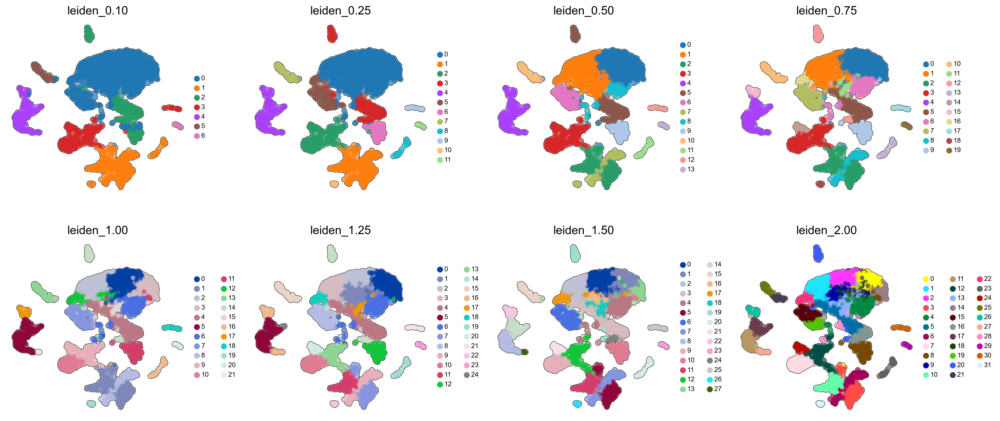

In [23]:
kws = {'s':125, 'legend_fontsize':8, 'add_outline':True, 'outline_width':(0.1, 0.01), 'outline_color':('#2f322f', 'white')}
color=['leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00']

with rc_context({'figure.figsize':(4, 4), "font.size":10}):
    sc.pl.umap(pcHVG_data, color=color, **kws)

In [ ]:
# Finding cluster markers
resolution = 'leiden_0.75'; method = 'wilcoxon'; key_added = method + '_' + resolution; print(key_added)
sc.tl.rank_genes_groups(pcHVG_data, resolution, method=method, corr_method="bonferroni", key_added = key_added, use_raw=False)
top_markers = pd.DataFrame(pcHVG_data.uns[key_added]['names']).head(5); print(top_markers)
#         .         .         .         .         .         .         .         .         .         .         .         .
with rc_context({'figure.figsize': (4, 4), "font.size":20}):
    sc.pl.rank_genes_groups(pcHVG_data, n_genes=20, key=key_added, sharey=False, show=False)
fig = plt.gcf(); fig.suptitle(key_added, fontsize=16, y=0.94); plt.show()

In [25]:
pcHVG_data

AnnData object with n_obs × n_vars = 5781 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00', 'umap', 'leiden_0.10_colors', 'leiden_0.25_colors', 'leiden_0.50_colors', 'leiden_0.75_colors', 'leiden_1.00_colors', 'leiden_1.25_colors', 'leiden_1.50_colors', 'leiden_2.00_colors', 'wilcoxon_leiden_0.75'

wilcoxon_leiden_0.50
          0        1       2         3       4     5       6      7         8         9      10      11      12       13
0  HLA-DRB1     SRGN    TFF1     IFI30   SPARC  CCL5  MT-ND6   KRT8    HSPA1B     STMN1    GZMB  JCHAIN  TPSAB1      TTR
1      CD83     IL32  SPINK1    TYROBP  COL1A1  NKG7    MYH9  KRT19    HSPA1A     GAPDH  JCHAIN    IGKC    CPA3     TFF3
2      CD69  TNFRSF4     LYZ  HLA-DRB1  COL3A1  GZMA    LCP1   ELF3    DNAJB1  HIST1H4C    SOX4   IGHA1   TPSB2  C6orf58
3      IGHM    KLRB1   KRT19      IL1B  COL1A2  CST7     UBC  NEAT1  HSP90AA1      RRM2    IRF7    TFF1     VIM   PCSK1N
4  HLA-DRB5    ZFP36   IFI27    FCER1G     LUM  SRGN   MACF1  KRT18      CD69      TYMS  TYROBP    MZB1   HPGDS   BPIFB2


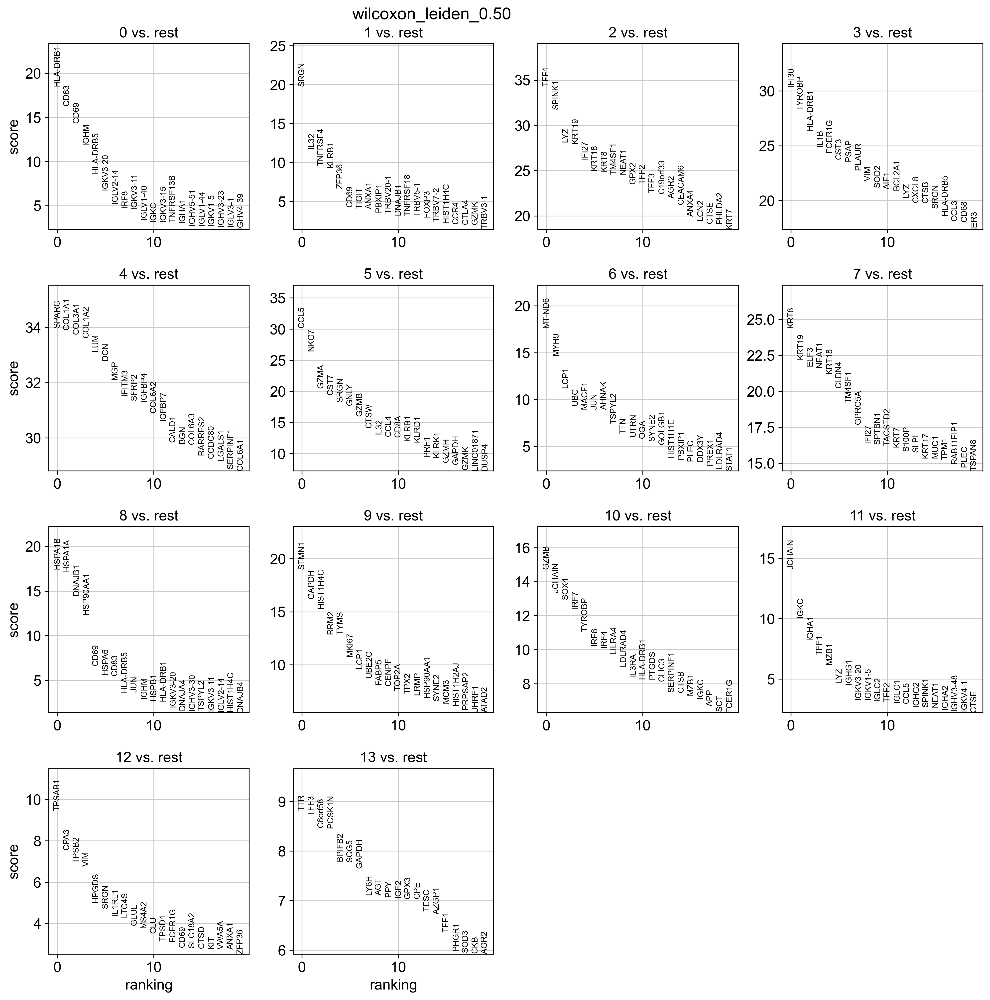

In [37]:
# Finding cluster markers
resolution = 'leiden_0.50'; method = 'wilcoxon'; key_added = method + '_' + resolution; print(key_added)
sc.tl.rank_genes_groups(pcHVG_data, resolution, method='wilcoxon', corr_method="bonferroni", key_added = key_added, use_raw=False, pts=True)
top_markers = pd.DataFrame(pcHVG_data.uns[key_added]['names']).head(5); print(top_markers)
#         .         .         .         .         .         .         .         .         .         .         .         .
with rc_context({'figure.figsize': (4, 4), "font.size":20}):
    sc.pl.rank_genes_groups(pcHVG_data, n_genes=20, key=key_added, sharey=False, show=False)
fig = plt.gcf(); fig.suptitle(key_added, fontsize=16, y=0.94); plt.show()

In [38]:
pcHVG_data

AnnData object with n_obs × n_vars = 5781 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00', 'umap', 'leiden_0.10_colors', 'leiden_0.25_colors', 'leiden_0.50_colors', 'leiden_0.75_colors', 'leiden_1.00_colors', 'leiden_1.25_colors', 'leiden_1.50_colors', 'leiden_2.00_colors', 'wilcoxon_leiden_0.75'

In [28]:
cluster_dict = {}
for col in top_markers.columns:              # Loop through columns dynamically
    col_list = top_markers[col].tolist()     # Convert the column to a list
    # Format the column index as a string with leading zeros (e.g., "00", "01", "02", ...)
    cluster_label = f"{int(col)}"            # {int(i):02d}
    cluster_dict[cluster_label] = col_list   # Add the cluster name and corresponding gene list to the dict
    print(f'\33[31m cluster_{cluster_label}: \x1b[0m', col_list)

 cluster_0:  ['HLA-DRB1', 'CD83', 'CD69', 'IGHM', 'HLA-DRB5']
 cluster_1:  ['SRGN', 'IL32', 'TNFRSF4', 'KLRB1', 'ZFP36']
 cluster_2:  ['TFF1', 'SPINK1', 'LYZ', 'KRT19', 'IFI27']
 cluster_3:  ['IFI30', 'TYROBP', 'HLA-DRB1', 'IL1B', 'FCER1G']
 cluster_4:  ['SPARC', 'COL1A1', 'COL3A1', 'COL1A2', 'LUM']
 cluster_5:  ['CCL5', 'NKG7', 'GZMA', 'CST7', 'SRGN']
 cluster_6:  ['MT-ND6', 'MYH9', 'LCP1', 'UBC', 'MACF1']
 cluster_7:  ['KRT8', 'KRT19', 'ELF3', 'NEAT1', 'KRT18']
 cluster_8:  ['HSPA1B', 'HSPA1A', 'DNAJB1', 'HSP90AA1', 'CD69']
 cluster_9:  ['STMN1', 'GAPDH', 'HIST1H4C', 'RRM2', 'TYMS']
 cluster_10:  ['GZMB', 'JCHAIN', 'SOX4', 'IRF7', 'TYROBP']
 cluster_11:  ['JCHAIN', 'IGKC', 'IGHA1', 'TFF1', 'MZB1']
 cluster_12:  ['TPSAB1', 'CPA3', 'TPSB2', 'VIM', 'HPGDS']
 cluster_13:  ['TTR', 'TFF3', 'C6orf58', 'PCSK1N', 'BPIFB2']


In [ ]:
resolution = 'leiden_0.75'
with rc_context({'figure.figsize': (4, 4), "font.size":8}):
    sc.pl.umap(pcHVG_data, color=[resolution, 'CST3', 'NKG7', 'TNFRSF4'], size=150, wspace=0.1, legend_fontsize=16, legend_loc="on data")

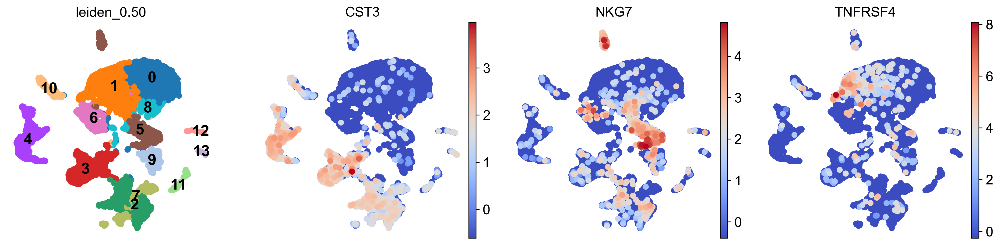

In [30]:
resolution = 'leiden_0.50'
with rc_context({'figure.figsize': (4, 4), "font.size":8}):
    sc.pl.umap(pcHVG_data, color=[resolution, 'CST3', 'NKG7', 'TNFRSF4'], size=150, wspace=0.1, legend_fontsize=16, legend_loc="on data")

In [31]:
# Wilcoxon rank-sum
sc.tl.rank_genes_groups(pcHVG_data, 'leiden_0.50', method='wilcoxon', corr_method="bonferroni", key_added = "wilcoxon")
#          -          -          -          -          -          -          -          -          -          -          -          -   
# T-test
sc.tl.rank_genes_groups(pcHVG_data, 'leiden_0.50', method='t-test', key_added = "t-test")
#sc.pl.rank_genes_groups(pcHVG_data, n_genes=25, sharey=False, key = "t-test")
#          -          -          -          -          -          -          -          -          -          -          -          -   
# T-test overestimated_variance
sc.tl.rank_genes_groups(pcHVG_data, 'leiden_0.50', method='t-test_overestim_var', key_added = "t-test_ov")
#sc.pl.rank_genes_groups(pcHVG_data, n_genes=25, sharey=False, key = "t-test_ov")
#          -          -          -          -          -          -          -          -          -          -          -          -   
# Logistic regression test
sc.tl.rank_genes_groups(pcHVG_data, 'leiden_0.50', method='logreg',key_added = "logreg")
#sc.pl.rank_genes_groups(pcHVG_data, n_genes=25, sharey=False, key = "logreg")

In [32]:
pcHVG_data

AnnData object with n_obs × n_vars = 5781 × 1460
    obs: 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ri', 'pct_counts_ri', 'total_counts_hb', 'pct_counts_hb', 'outlier_ngenes', 'outlier_total', 'outlier_hb', 'outlier_mt', 'outlier_ri', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00'
    var: 'ensembl_id', 'gene_catg', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'mt', 'ri', 'hb', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'pca', 'neighbors', 'leiden_0.10', 'leiden_0.25', 'leiden_0.50', 'leiden_0.75', 'leiden_1.00', 'leiden_1.25', 'leiden_1.50', 'leiden_2.00', 'umap', 'leiden_0.10_colors', 'leiden_0.25_colors', 'leiden_0.50_colors', 'leiden_0.75_colors', 'leiden_1.00_colors', 'leiden_1.25_colors', 'leiden_1.50_colors', 'leiden_2.00_colors', 'wilcoxon_leiden_0.75'

In [33]:
# Initialize the dictionary with 'Clusters' as a key
marker_genes = {"Clusters": [resolution]}       # 'resolution' should be predefined

# Loop through the columns of the DataFrame 'top_markers'
for i, col in enumerate(top_markers.columns):  
    # Create the dynamic variable name (e.g., 'cluster_00', 'cluster_01', ...)
    var_name = f"cluster_{int(i)}"
    # Convert the column to a list and assign it to the dynamically created variable
    globals()[var_name] = top_markers[col].tolist()
    # Create the dictionary key and add the list to the dictionary
    cluster_key = f"cluster_{int(i)}"  # E.g., 'Cluster_00', 'Cluster_01', etc.
    marker_genes[cluster_key] = top_markers[col].tolist()
# Print the resulting dictionary
print(marker_genes)

{'Clusters': ['leiden_0.50'], 'cluster_0': ['HLA-DRB1', 'CD83', 'CD69', 'IGHM', 'HLA-DRB5'], 'cluster_1': ['SRGN', 'IL32', 'TNFRSF4', 'KLRB1', 'ZFP36'], 'cluster_2': ['TFF1', 'SPINK1', 'LYZ', 'KRT19', 'IFI27'], 'cluster_3': ['IFI30', 'TYROBP', 'HLA-DRB1', 'IL1B', 'FCER1G'], 'cluster_4': ['SPARC', 'COL1A1', 'COL3A1', 'COL1A2', 'LUM'], 'cluster_5': ['CCL5', 'NKG7', 'GZMA', 'CST7', 'SRGN'], 'cluster_6': ['MT-ND6', 'MYH9', 'LCP1', 'UBC', 'MACF1'], 'cluster_7': ['KRT8', 'KRT19', 'ELF3', 'NEAT1', 'KRT18'], 'cluster_8': ['HSPA1B', 'HSPA1A', 'DNAJB1', 'HSP90AA1', 'CD69'], 'cluster_9': ['STMN1', 'GAPDH', 'HIST1H4C', 'RRM2', 'TYMS'], 'cluster_10': ['GZMB', 'JCHAIN', 'SOX4', 'IRF7', 'TYROBP'], 'cluster_11': ['JCHAIN', 'IGKC', 'IGHA1', 'TFF1', 'MZB1'], 'cluster_12': ['TPSAB1', 'CPA3', 'TPSB2', 'VIM', 'HPGDS'], 'cluster_13': ['TTR', 'TFF3', 'C6orf58', 'PCSK1N', 'BPIFB2']}


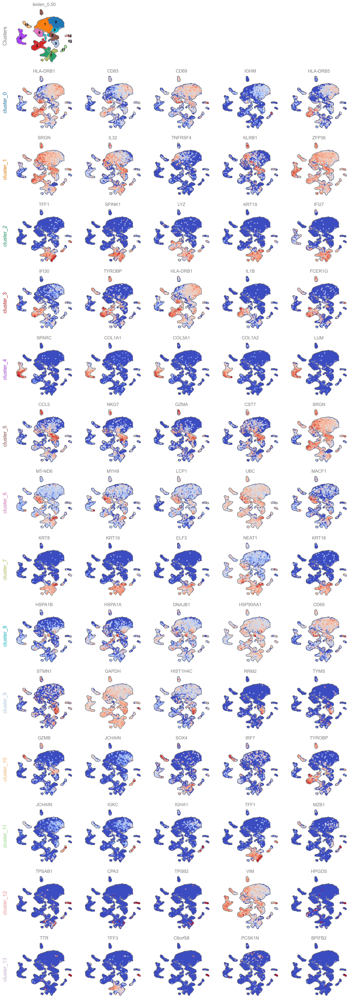

CPU times: total: 26.8 s
Wall time: 27 s


In [34]:
%%time
#         .         .         .         .         .         .         .         .         .         .         .         .
umap_kws = {'s':50,'add_outline':True, 'outline_width':(0.25, 0.01),  'outline_color':('#505050', 'white'),'show':False, 
            'legend_fontsize':10, 'legend_loc':"on data", 'colorbar_loc':None, 'frameon':False, 'cmap':None}
#         .         .         .         .         .         .         .         .         .         .         .         .
nrow = len(marker_genes); ncol = max([len(vs) for vs in marker_genes.values()])
#         .         .         .         .         .         .         .         .         .         .         .         .
uns_colors = resolution + "_colors"

# Define the layout for subplots
fig, axs = plt.subplots(nrow, ncol, figsize=(2.7 * ncol, 2.5 * nrow))
plt.subplots_adjust(wspace=0.1, hspace=0.2)
# Fetch the cluster colors from pcHVG_data.uns
cluster_colors = pcHVG_data.uns.get(uns_colors, None)
if not cluster_colors:
    raise ValueError("No cluster colors found in {uns_colors}.")
# Iterate over the rows and markers
for row_idx, (cell_type, markers) in enumerate(marker_genes.items()):
    col_idx = 0
    for marker in markers:                # Use the color corresponding to the cluster
        cluster_idx = row_idx - 1         # Assuming row index maps directly to the cluster index
        if cluster_idx < len(cluster_colors):
            cluster_color = cluster_colors[cluster_idx]
        else:
            print(f"Warning: No color defined for cluster index {cluster_idx}. Using default.")
            cluster_color = "#7E7E7E"  # Fallback color
#         .         .         .         .         .         .         .         .         .         .         .         .        
        ax = axs[row_idx][col_idx]
        im = sc.pl.umap(pcHVG_data, color=marker, ax=ax, **umap_kws)
        ax.set_ylabel(cell_type + "\n", fontsize=14, color=cluster_color, rotation=90)
        ax.set_title(marker, fontsize=12, color="#7E7E7E", pad=5)   # Set the title and legend
        handles, labels = ax.get_legend_handles_labels()
        im.legend(handles[:], labels[:], fontsize=8, markerscale=1, bbox_to_anchor=(1, 1), loc=2, handletextpad=0.5,
                  labelspacing=0.5, frameon=False)
#         .         .         .         .         .         .         .         .         .         .         .         .            
        if col_idx == 0 and row_idx == 0:
            ax.axis("on"); ax.set(frame_on=False)
            ax.set_ylabel(cell_type + "\n", fontsize=14, color='#7E7E7E', rotation=90)
            ax.set_xlabel('',               fontsize=0,  color="#7E7E7E", rotation=0)
        if col_idx == 0:
            ax.axis("on"); ax.set(frame_on=False)
            ax.tick_params(top=False, bottom=False, left=False, right=False, labelleft=True, labelbottom=False)
            ax.set_xlabel('',               fontsize=0,  color="#7E7E7E", rotation=0)
#         .         .         .         .         .         .         .         .         .         .         .         .    
        col_idx += 1
    while col_idx < ncol:
        axs[row_idx][col_idx].remove()
        col_idx += 1
fig.tight_layout(); plt.show()

In [ ]:
%%time
#         .         .         .         .         .         .         .         .         .         .         .         .
umap_kws = {'s':50,'add_outline':True, 'outline_width':(0.25, 0.01),  'outline_color':('#505050', 'white'),'show':False, 
            'legend_fontsize':10, 'legend_loc':"on data", 'colorbar_loc':None, 'frameon':False, 'cmap':None}
#         .         .         .         .         .         .         .         .         .         .         .         .
nrow = len(marker_genes); ncol = max([len(vs) for vs in marker_genes.values()])
#         .         .         .         .         .         .         .         .         .         .         .         .
fig, axs = plt.subplots(nrow, ncol, figsize=(2.7*ncol,2.5*nrow))
plt.subplots_adjust(wspace=0.1, hspace=0.2)
#         .         .         .         .         .         .         .         .         .         .         .         .
for row_idx, (cell_type, markers) in enumerate(marker_genes.items()):
    col_idx = 0
    for marker in markers:
        ax = axs[row_idx, col_idx]
        im = sc.pl.umap(pcHVG_data, color=marker, ax=ax, **umap_kws)
        ax.set_title(marker, fontsize=12, color="#7E7E7E", pad=5) ; "#7E7E7E"
        handles, labels = ax.get_legend_handles_labels()
        im.legend(handles[:], labels[:], fontsize=8, markerscale=1, bbox_to_anchor=(1, 1), loc=2,
                  handletextpad=0.5, labelspacing=0.5, frameon=False)
        if col_idx == 0:
            ax.axis("on")
            ax.tick_params(top="off", bottom="off", left="off", right="off", labelleft="on", labelbottom="off")
            ax.set_ylabel(cell_type + "\n", fontsize=14, color="#7E7E7E", rotation=90)
            ax.set_xlabel('',               fontsize=0,  color="#7E7E7E", rotation=0)
            ax.set(frame_on=False)
#         .         .         .         .         .         .         .         .         .         .         .         .    
        col_idx += 1
    while col_idx < ncol:
        axs[row_idx, col_idx].remove()
        col_idx += 1
fig.tight_layout();

In [ ]:
# Now concatenate all the gene lists from the generated variables into one list
top_markers_genes = []
n_clusters = len(top_markers.columns); print(f"\033[31mNumber of Clusters: {n_clusters}\033[0m", "\n")
#          -          -          -          -          -          -          -          -          -          -          -          -   
for i in range(n_clusters):          # Loop through the number of clusters
    var_name = f"cluster_{int(i):2d}"             # Generate the variable name (e.g., 'cluster_00')
    top_markers_genes.extend(globals()[var_name])  # Add the list from the variable to 'all_genes'
    #          -          -          -          -          -          -          -          -          -          -          -          -   
print(f"\033[33mTop 5 Marker Genes per Cluster: {top_markers_genes}\033[0m", "\n")

In [ ]:
#top_markers_genes = ['CD83', 'HLA-DRB1', 'CD69', 'IGHM', 'HLA-DRB5', 'TFF1', 'SPINK1', 'LYZ', 'KRT19', 'IFI27', 'SRGN', 'IL32', 'TNFRSF4', 'KLRB1', 'ANXA1']

In [ ]:
#top_markers_genes = ['CD83', 'RAB5A', 'RAB5B', 'ERBB3', 'ERBB2', 'CTLA4'] # CCL3
#top_markers_genes = ['CD83', 'SSKIL', 'ISG15', 'CCL22', 'PLAC8', 'CD52', 'S100A9', 'LAMP3', 'CD2']

In [ ]:
%%time
#          -          -          -          -          -          -          -          -          -          -          -          -         
count_gene = 1
plt.subplots(figsize=(20/2.54, 50/2.54), dpi=300); plt.subplots_adjust(wspace=-0.2, hspace=-0.2); plt.axis('off')
#          -          -          -          -          -          -          -          -          -          -          -          -        
for gene in top_markers_genes:
    kws1 = {'s': 1.2, 'jitter': .35, 'alpha': 0.5, 'dodge': True, 'linewidth': 0.1, 'edgecolor': '#1E1E1E'}
    kws2 = {'linewidth': 0.5, 'width': 0.7, 'dodge': True, 'showcaps': True, 'whis': 1.5, 'fliersize': 0, 'saturation': 0.20}
    medianprops  = dict(linestyle='-', linewidth=1, color="firebrick", alpha=0.8)
    capprops     = dict(linestyle="-", alpha=.4, linewidth=.5); boxprops = dict(linestyle="-", alpha=.4, linewidth=.5)
    whiskerprops = dict(linestyle="--", linewidth=.5, color="#7E7E7E")
#          -          -          -          -          -          -          -          -          -          -          -          -          
    ax = plt.subplot(n_clusters, 5, count_gene)
    try:
        plotdf = sc.get.obs_df(pcHVG_data, keys=[gene, resolution], obsm_keys=[("X_umap", 0), ("X_umap", 1)])
        sns.stripplot(data=plotdf, x=resolution, y=gene, **kws1, zorder=0, ax=ax)
    except KeyError:
        ax.set_title(gene, fontsize=6, color="#7E7E7E", pad=5)
        ax.text(0.5, 0.5, 'Gene not found', ha='center', va='center', fontsize=6, color="#FF0000")
        ax.set_xlim(0, 1); ax.set_ylim(0, 1); ax.axis('off')
        plt.legend([], [], frameon=False)
        sns.despine(left=True, bottom=True)
    else:
        ax.set_title(gene, fontsize=6, color="#7E7E7E", pad=5)
        plt.xlabel("", fontsize=0, color="#7E7E7E", labelpad=0); plt.ylabel('', fontsize=0, color="#7E7E7E", labelpad=2)
        ax.set_ylim([-1.9, 12]); ax.set_yscale('linear'); 
        ax.tick_params(axis="x", colors="#cfcfcf", pad=0, length=0);      ax.tick_params(axis="y", colors="#cfcfcf", pad=0, length=0)
        plt.xticks(fontsize=4, color="#7E7E7E", rotation=0, ha="center"); ax.tick_params(axis='x', which='major', pad=-1.5)
        plt.yticks(fontsize=5, color="#7E7E7E", rotation=0, ha="center"); ax.tick_params(axis='y', which='major', pad=6)
        sns.despine(left=True, bottom=True)
        plt.legend([], [], frameon=False)
#          -          -          -          -          -          -          -          -          -          -          -          -              
    plt.tight_layout()
    count_gene += 1
#          -          -          -          -          -          -          -          -          -          -          -          -         
plt.tight_layout()
plt.show(); #plt.close()

In [ ]:
# scale and store results in layer
pcHVG_data.layers["scaled"] = sc.pp.scale(pcHVG_data, copy=True).X

In [ ]:
sc.pl.heatmap(pcHVG_data, var_names=top_markers_genes, groupby=resolution, layer="scaled", vmin=-2, vmax=10, cmap="RdBu_r", dendrogram=True,
    swap_axes=True, show_gene_labels=True, figsize=(25, 18), show=True)
#plt.yticks(fontsize=4, color="#7E7E7E", rotation=0, ha="center")

In [ ]:
plt.rcParams.update({'axes.labelsize': '12'})  # Axis labels
sc.pl.heatmap(pcHVG_data, var_names=top_markers_genes, groupby=resolution, layer="scaled",  vmin=-1, vmax=5, vcenter=0, norm=None, cmap="RdBu_r",
              dendrogram=True, swap_axes=True, show_gene_labels=True, figsize=(25, 20), show=False)
plt.show()

In [ ]:
sc.pl.heatmap(pcHVG_data, var_names=top_markers_genes, groupby=resolution, layer="scaled", vmin=-1,  vmax=7,  cmap='PuBu', dendrogram=True,
              swap_axes=True,  show_gene_labels=True, figsize=(25, 20), show=True)
#plt.yticks(fontsize=4, color="#7E7E7E", rotation=0, ha="center")

In [ ]:
pcHVG_data

In [ ]:
pcHVG_data.var.columns = pcHVG_data.var.columns.astype(str) # Ensure all column names are strings
pcHVG_data.write(pcHVG_h5ad_file_path )

In [ ]:
# Path to your audio file
audio_file = "../../data/clock-chime-88027.mp3"
display(Audio(audio_file, autoplay=True))

In [ ]:
elapsed_time = time.time() - code_start
minutes, seconds = divmod(elapsed_time, 60)
print("'GSE279781_02.Preproc_v01' script run time:", f"{int(minutes)} min {int(seconds)} sec.")